<a href="https://colab.research.google.com/github/UdaySMukherjee/GAN-CIFAR10/blob/main/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [ ]:
# Root directory for dataset
dataroot = "/content/drive/MyDrive/FurnitureDataset_RPA"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator .9
ngf = 64

# Size of feature maps in discriminator .1
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.01

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


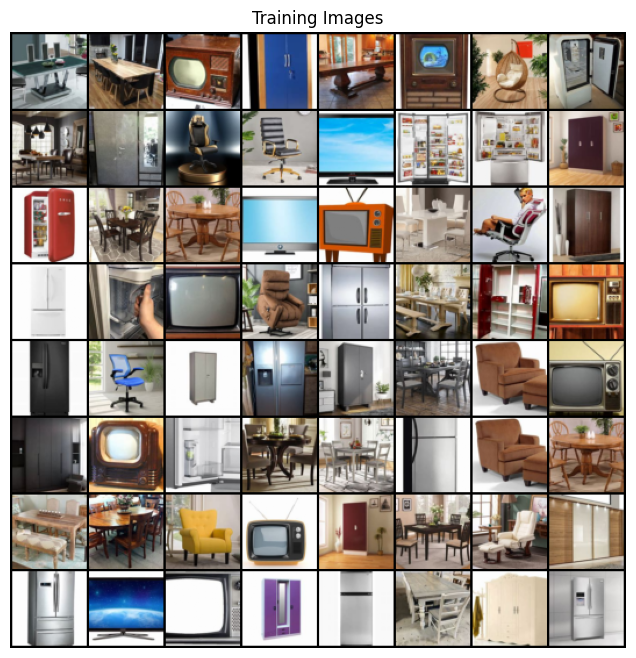

In [ ]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)
# Decide which device to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# to ``mean=0``, ``stdev=0.02``.
# netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
# netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.SGD(netD.parameters(), lr=lr)
optimizerG = optim.SGD(netG.parameters(), lr=lr)

In [ ]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Apply weight to generator's loss
        weighted_errG = 0.9 * errG  # Apply the weight here
        # Calculate gradients for G
        weighted_errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
          print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (epoch, num_epochs, i, len(dataloader),
                        errD.item(), weighted_errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(weighted_errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/100][0/118]	Loss_D: 1.4411	Loss_G: 2.3445	D(x): 0.4952	D(G(z)): 0.5099 / 0.0781
[0/100][50/118]	Loss_D: 3.5242	Loss_G: 30.7524	D(x): 0.9751	D(G(z)): 0.9555 / 0.0000
[0/100][100/118]	Loss_D: 2.9214	Loss_G: 8.4434	D(x): 0.9900	D(G(z)): 0.8944 / 0.0003
[1/100][0/118]	Loss_D: 1.7741	Loss_G: 6.6470	D(x): 0.9345	D(G(z)): 0.6562 / 0.0060
[1/100][50/118]	Loss_D: 2.5751	Loss_G: 6.6726	D(x): 0.9862	D(G(z)): 0.8785 / 0.0031
[1/100][100/118]	Loss_D: 2.0733	Loss_G: 2.9617	D(x): 0.8779	D(G(z)): 0.7718 / 0.0662
[2/100][0/118]	Loss_D: 0.9380	Loss_G: 3.6225	D(x): 0.9286	D(G(z)): 0.5221 / 0.0319
[2/100][50/118]	Loss_D: 1.2754	Loss_G: 2.4351	D(x): 0.7197	D(G(z)): 0.4988 / 0.1476
[2/100][100/118]	Loss_D: 2.0121	Loss_G: 3.5544	D(x): 0.9292	D(G(z)): 0.8156 / 0.0294
[3/100][0/118]	Loss_D: 0.8960	Loss_G: 5.0946	D(x): 0.9633	D(G(z)): 0.5113 / 0.0068
[3/100][50/118]	Loss_D: 1.6585	Loss_G: 8.2038	D(x): 0.9339	D(G(z)): 0.6739 / 0.0003
[3/100][100/118]	Loss_D: 0.8882	Loss_G: 3.8460	D(x

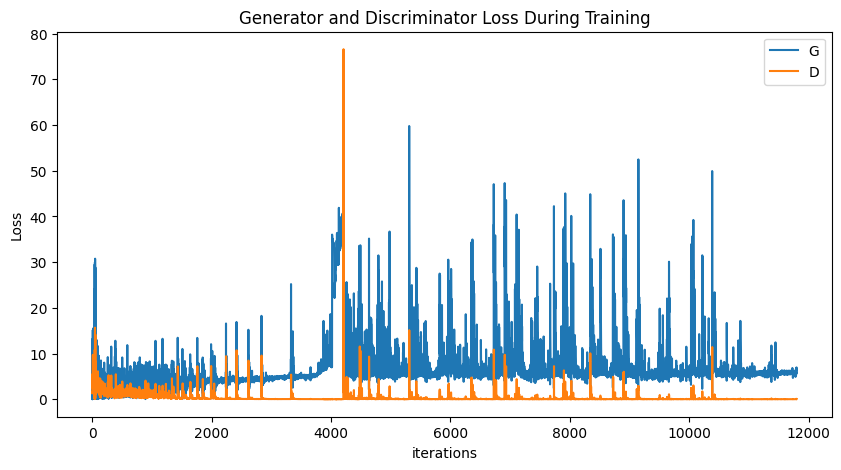

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

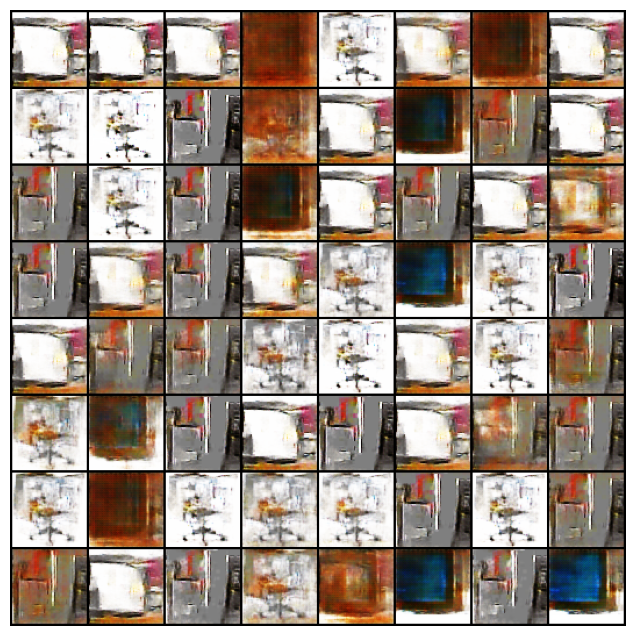

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

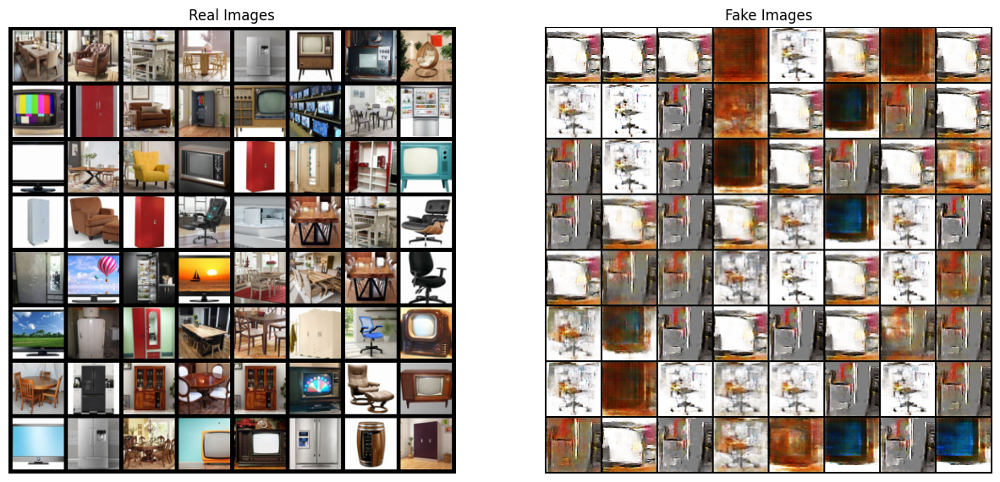

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

2nd Version


In [ ]:
from google.colab.patches import cv2_imshow


Random Seed:  9886
Files already downloaded and verified
Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2

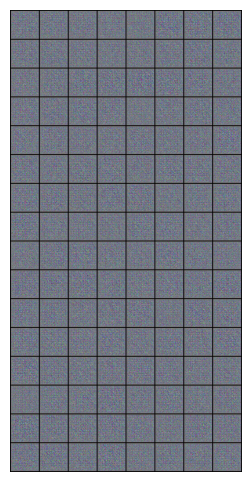

[0/15][1/391] Loss_D: 1.1023 Loss_G: 4.7956 D(x): 0.5378 D(G(z)): 0.2615 / 0.0123
[0/15][2/391] Loss_D: 1.2429 Loss_G: 6.0387 D(x): 0.8110 D(G(z)): 0.5351 / 0.0043
[0/15][3/391] Loss_D: 1.0114 Loss_G: 6.4056 D(x): 0.6896 D(G(z)): 0.3389 / 0.0029
[0/15][4/391] Loss_D: 0.8223 Loss_G: 6.8882 D(x): 0.7663 D(G(z)): 0.3246 / 0.0018
[0/15][5/391] Loss_D: 1.0484 Loss_G: 7.7422 D(x): 0.7668 D(G(z)): 0.4265 / 0.0008
[0/15][6/391] Loss_D: 1.1926 Loss_G: 7.1778 D(x): 0.6162 D(G(z)): 0.2921 / 0.0014
[0/15][7/391] Loss_D: 1.2176 Loss_G: 9.2817 D(x): 0.7392 D(G(z)): 0.4922 / 0.0002
[0/15][8/391] Loss_D: 0.7500 Loss_G: 7.6870 D(x): 0.6839 D(G(z)): 0.1596 / 0.0009
[0/15][9/391] Loss_D: 1.2385 Loss_G: 10.4666 D(x): 0.7903 D(G(z)): 0.5350 / 0.0001
[0/15][10/391] Loss_D: 0.5721 Loss_G: 7.9852 D(x): 0.7031 D(G(z)): 0.0621 / 0.0008
[0/15][11/391] Loss_D: 0.9452 Loss_G: 9.9550 D(x): 0.7925 D(G(z)): 0.3889 / 0.0001
[0/15][12/391] Loss_D: 0.3442 Loss_G: 9.0912 D(x): 0.8571 D(G(z)): 0.1307 / 0.0002
[0/15][13/39

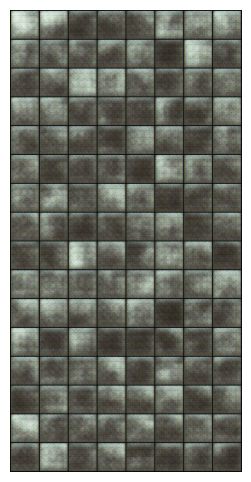

[0/15][101/391] Loss_D: 0.7966 Loss_G: 3.2824 D(x): 0.6005 D(G(z)): 0.0270 / 0.0540
[0/15][102/391] Loss_D: 0.5483 Loss_G: 5.1640 D(x): 0.9345 D(G(z)): 0.3485 / 0.0088
[0/15][103/391] Loss_D: 0.3764 Loss_G: 4.5559 D(x): 0.8125 D(G(z)): 0.0875 / 0.0151
[0/15][104/391] Loss_D: 0.4528 Loss_G: 3.8101 D(x): 0.8148 D(G(z)): 0.1364 / 0.0347
[0/15][105/391] Loss_D: 0.5551 Loss_G: 4.9026 D(x): 0.8440 D(G(z)): 0.2604 / 0.0145
[0/15][106/391] Loss_D: 0.4308 Loss_G: 4.0860 D(x): 0.8026 D(G(z)): 0.1135 / 0.0249
[0/15][107/391] Loss_D: 0.4879 Loss_G: 3.5661 D(x): 0.8146 D(G(z)): 0.1890 / 0.0346
[0/15][108/391] Loss_D: 0.4725 Loss_G: 4.3767 D(x): 0.8320 D(G(z)): 0.2102 / 0.0167
[0/15][109/391] Loss_D: 0.4785 Loss_G: 3.6389 D(x): 0.7956 D(G(z)): 0.1384 / 0.0304
[0/15][110/391] Loss_D: 0.4554 Loss_G: 4.0097 D(x): 0.8305 D(G(z)): 0.1826 / 0.0251
[0/15][111/391] Loss_D: 0.4685 Loss_G: 3.7916 D(x): 0.8007 D(G(z)): 0.1670 / 0.0283
[0/15][112/391] Loss_D: 0.5267 Loss_G: 4.2361 D(x): 0.8114 D(G(z)): 0.2093 /

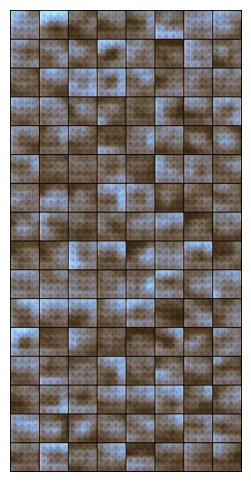

[0/15][201/391] Loss_D: 0.1921 Loss_G: 6.5138 D(x): 0.9392 D(G(z)): 0.1079 / 0.0025
[0/15][202/391] Loss_D: 0.1347 Loss_G: 6.0195 D(x): 0.9391 D(G(z)): 0.0528 / 0.0040
[0/15][203/391] Loss_D: 0.2159 Loss_G: 6.0322 D(x): 0.9223 D(G(z)): 0.1136 / 0.0044
[0/15][204/391] Loss_D: 0.1265 Loss_G: 6.4001 D(x): 0.9607 D(G(z)): 0.0780 / 0.0027
[0/15][205/391] Loss_D: 0.1379 Loss_G: 6.0081 D(x): 0.9406 D(G(z)): 0.0680 / 0.0039
[0/15][206/391] Loss_D: 0.2256 Loss_G: 5.1629 D(x): 0.8814 D(G(z)): 0.0738 / 0.0084
[0/15][207/391] Loss_D: 0.2664 Loss_G: 6.2411 D(x): 0.8981 D(G(z)): 0.1280 / 0.0030
[0/15][208/391] Loss_D: 0.1449 Loss_G: 5.9725 D(x): 0.9248 D(G(z)): 0.0509 / 0.0036
[0/15][209/391] Loss_D: 0.1183 Loss_G: 5.5565 D(x): 0.9442 D(G(z)): 0.0530 / 0.0049
[0/15][210/391] Loss_D: 0.1135 Loss_G: 6.5402 D(x): 0.9819 D(G(z)): 0.0882 / 0.0020
[0/15][211/391] Loss_D: 0.0900 Loss_G: 6.0474 D(x): 0.9502 D(G(z)): 0.0291 / 0.0036
[0/15][212/391] Loss_D: 0.1566 Loss_G: 5.6285 D(x): 0.9423 D(G(z)): 0.0834 /

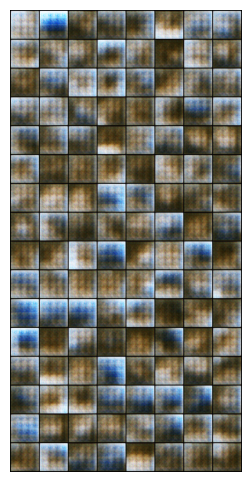

[0/15][301/391] Loss_D: 0.3174 Loss_G: 2.9636 D(x): 0.8385 D(G(z)): 0.0950 / 0.0702
[0/15][302/391] Loss_D: 0.5320 Loss_G: 7.6264 D(x): 0.9324 D(G(z)): 0.3364 / 0.0007
[0/15][303/391] Loss_D: 1.2047 Loss_G: 1.3074 D(x): 0.4379 D(G(z)): 0.0041 / 0.3254
[0/15][304/391] Loss_D: 0.9919 Loss_G: 9.2376 D(x): 0.9898 D(G(z)): 0.5895 / 0.0002
[0/15][305/391] Loss_D: 0.9549 Loss_G: 5.4168 D(x): 0.5359 D(G(z)): 0.0015 / 0.0100
[0/15][306/391] Loss_D: 0.1789 Loss_G: 3.0035 D(x): 0.9144 D(G(z)): 0.0616 / 0.0908
[0/15][307/391] Loss_D: 0.4260 Loss_G: 4.9712 D(x): 0.9644 D(G(z)): 0.2771 / 0.0160
[0/15][308/391] Loss_D: 0.4076 Loss_G: 3.5430 D(x): 0.8028 D(G(z)): 0.1147 / 0.0511
[0/15][309/391] Loss_D: 0.3807 Loss_G: 2.9914 D(x): 0.8337 D(G(z)): 0.1376 / 0.0738
[0/15][310/391] Loss_D: 0.3537 Loss_G: 4.5278 D(x): 0.9222 D(G(z)): 0.2045 / 0.0202
[0/15][311/391] Loss_D: 0.4552 Loss_G: 2.6915 D(x): 0.7413 D(G(z)): 0.0720 / 0.1004
[0/15][312/391] Loss_D: 0.4983 Loss_G: 5.0496 D(x): 0.9091 D(G(z)): 0.2865 /

RuntimeError: ignored

In [ ]:
from __future__ import print_function
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
cudnn.benchmark = True

#set manual seed to a constant get a consistent output
manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

#loading the dataset
dataset = dset.CIFAR10(root="./data", download=True,
                           transform=transforms.Compose([
                               transforms.Resize(64),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
nc=3

dataloader = torch.utils.data.DataLoader(dataset, batch_size=128,
                                         shuffle=True, num_workers=2)

#checking the availability of cuda devices
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# number of gpu's available
ngpu = 1
# input noise dimension
nz = 100
# number of generator filters
ngf = 64
#number of discriminator filters
ndf = 64

# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
            return output

netG = Generator(ngpu).to(device)
netG.apply(weights_init)
#load weights to test the model
#netG.load_state_dict(torch.load('weights/netG_epoch_24.pth'))
print(netG)

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)

        return output.view(-1, 1).squeeze(1)

netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
#load weights to test the model
#netD.load_state_dict(torch.load('weights/netD_epoch_24.pth'))
print(netD)

criterion = nn.BCELoss()

# setup optimizer
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))

fixed_noise = torch.randn(128, nz, 1, 1, device=device)
real_label = 1
fake_label = 0

niter = 15
g_loss = []
d_loss = []

for epoch in range(niter):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        # train with real
        netD.zero_grad()
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)

        output = netD(real_cpu)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # train with fake
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label).float()
        output = netD(fake.detach())
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        print('[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f D(x): %.4f D(G(z)): %.4f / %.4f' % (epoch, niter, i, len(dataloader), errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Inside your training loop where you save generated images:
        if i % 100 == 0:
            print('saving and displaying the output')
            fake = netG(fixed_noise)
            vutils.save_image(fake.detach(), '../fake_samples_epoch_%03d.png' % (epoch), normalize=True)

            # Load the saved image using Matplotlib
            generated_image = mpimg.imread('../fake_samples_epoch_%03d.png' % (epoch))

            # Display the generated image using Matplotlib
            plt.figure(figsize=(6, 6))
            plt.imshow(generated_image)
            plt.axis('off')
            plt.show()

    # Check pointing for every epoch
    torch.save(netG.state_dict(), 'weights/netG_epoch_%d.pth' % (epoch))
    torch.save(netD.state_dict(), 'weights/netD_epoch_%d.pth' % (epoch))